In [32]:
from sklearn.feature_extraction.text import CountVectorizer
import pandas as pd
import os
import re
from sklearn.model_selection import train_test_split
import random as rd
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt 
My_FN_CV = CountVectorizer(input = "filename", stop_words="english")

## Set the path for the folder where POS and NEG are located
## This will also be the path where my csv file is.
MyPath="/Users/Max/Documents/Text mining /Raw_text_speeches_Coded_President/"

## Now - ALWAYS takes the time to make sure that you can access files
## In other words - TEST you Code!

Biden_files=os.listdir(MyPath+"/Biden")
# print(Biden_files)
Wash_files=os.listdir(MyPath+"/Washington")
# print(Wash_files)
MyCompleteFileNames=[]
MyLabels=[]

## Now I need a loop because there is no way to know (in real life) how
## many files are in each corpus. 
## While I can make this even more advanced and use a loop for the folder names
## as well - I will leave that to you to think about.
## I know that my two folders are called POS and NEG and so will "hard code"
## that in......................................

## You will notice that I am going to use a nested (double) loop
## The outer loop will go through each corpus. I only have two here: POS and NEG
## but this code can be updated to work for any number of corpus's 
## with some creativity........................

##_-----------------------------------------------------------
for folderName in ['Coolidge','Tyler','Biden','Wilson','Ford','Pierce','Lincoln','Bush Sr.','Washington',
                   'Reagan','Cleveland22','Hoover','Jefferson','FDR','Andrew Johnson','Monroe','Van Buren',
                   'Carter','Taft','Madison','Eisenhower','Henry Harrison','Buchanan','JQA','Adams','Arthur',
                   'Fillmore','Kennedy','Hayes','Obama','Bush Jr.','Johnson','Cleveland','Nixon','Harrison',
                   'Taylor','Clinton','Trump','Truman', 'Garfield','Harding','McKinley','TR','Polk','Grant',
                   'Jackson']:
    ## Get the files 
    filenames=os.listdir(MyPath + folderName)
    #print(filenames)  
    
    
    for eachfile in filenames:
        #print(eachfile)
        ## The "str" assures that everything is a string
        fullpath=MyPath + str(folderName) + "/" + str(eachfile)
        # C:/Users/profa/Documents/Python Scripts/TextMining/Week2_3/POS/P1.txt
#         print(fullpath)
        MyCompleteFileNames.append(fullpath)
        MyLabels.append(folderName)
        
# print("THe labels are:\n")
# print(MyLabels)     

# print("THe complete list of file paths is:\n")
# print(MyCompleteFileNames)     

########################### Next, we can use
## The proper CountVecotorizer and process the text data WITH the labels...   

## Now - let's use fit.transform to transform the list of files                                 
MyTextData1 = My_FN_CV.fit_transform(MyCompleteFileNames)
## MyTextData1 is a DTM
# print(type(MyTextData1))
## Get the column names
MyCol_Names=My_FN_CV.get_feature_names_out()
## Be careful - if you print all the col names there may be 100s or 1000s :)

## Create the dataframe...
FinalDF = pd.DataFrame(MyTextData1.toarray(), columns=MyCol_Names)
# print(MyDF_Pos_Neg.head())

# print(type(MyLabels))
## It is a list. 
## Let's 
FinalDF['LABEL'] = MyLabels
## Check it now
# print(FinalDF.head())




######### NOTICE that the data frame has numbers as columns.
## This is not good unless you are specifically looking for numeric values

## Remove all columns with numbers
# print("The first DF is: \n", FinalDF.head())


for nextcol in FinalDF.columns:
    if(re.search(r'[^A-Za-z]+', nextcol)):
#         print(nextcol)
        FinalDF=FinalDF.drop([nextcol], axis=1)
#    ## The following will remove any column with name
#    ## of 3 or smaller - like "it" or "of" or "pre".
#    ##print(len(nextcol))  ## check it first
#    ## NOTE: You can also use this code to CONTROL
#    ## the words in the columns. For example - you can
#    ## have only words between lengths 5 and 9. 
#    ## In this case, we remove columns with words <= 3.

    elif(len(str(nextcol))<6):
#                 print(nextcol)
        FinalDF=FinalDF.drop([nextcol], axis=1)
    elif(len(str(nextcol))>15):
#                 print(nextcol)
        FinalDF=FinalDF.drop([nextcol], axis=1)
    elif(nextcol in RemoveWords):
#                 print(nextcol)
        FinalDF=FinalDF.drop([nextcol], axis=1)
    elif(len(str(nextcol))<=3):
        print(nextcol)
        FinalDF=FinalDF.drop([nextcol], axis=1)
print(FinalDF)        
    

        

      abandon  abandoned  abandoning  abandonment  abandons  abashed  abated  \
0           1          0           0            0         0        0       0   
1           0          0           0            0         0        0       0   
2           0          0           0            0         0        0       0   
3           2          1           0            0         0        0       0   
4           0          0           0            0         0        0       0   
...       ...        ...         ...          ...       ...      ...     ...   
1029        1          0           0            0         0        0       0   
1030        0          1           0            0         0        0       0   
1031        0          0           0            0         0        0       0   
1032        1          1           0            0         0        0       0   
1033        0          1           0            1         0        0       0   

      abatement  abating  abbott  ...  

In [33]:
FinalDF['LABEL'] = MyLabels

Text(0.5, 1.0, 'All_comnined')

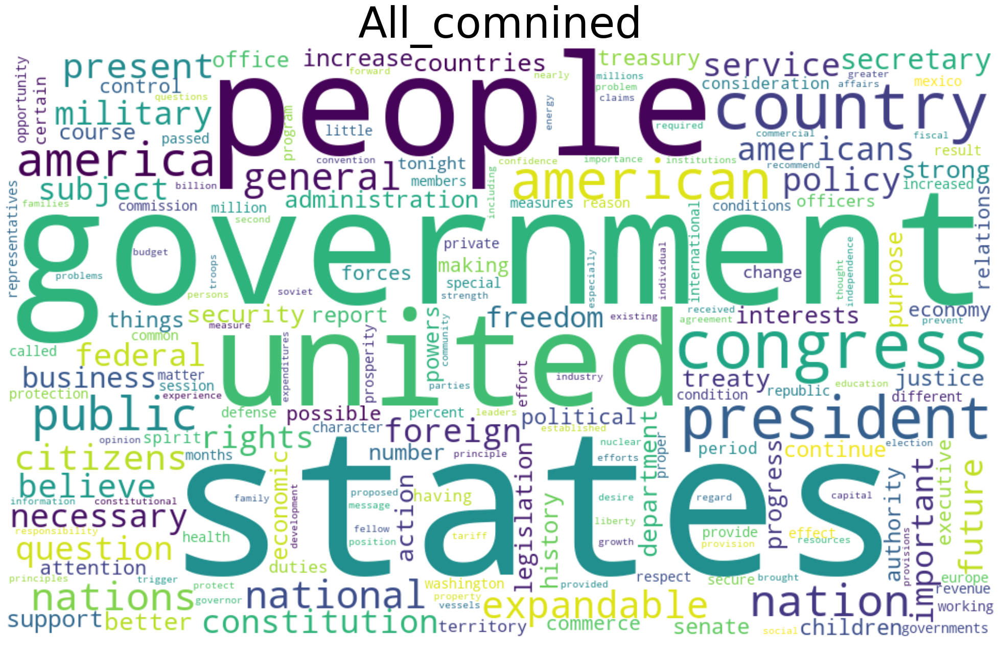

In [2]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
tempdf = FinalDF
        
#         print(tempdf)

tempdf =tempdf.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("All_comnined", fontsize=60)

In [23]:
RemoveWords=["states",'government',"american","america","country","americans","united","people","president","congress",
            "national","nations","public","nation"]


for nextcol in FinalDF.columns:
    
    if(nextcol in RemoveWords):
#                 print(nextcol)
        FinalDF=FinalDF.drop([nextcol], axis=1)
    elif(len(str(nextcol))<=3):
#         print(nextcol)
        FinalDF=FinalDF.drop([nextcol], axis=1)
 

Text(0.5, 1.0, 'All_comnined')

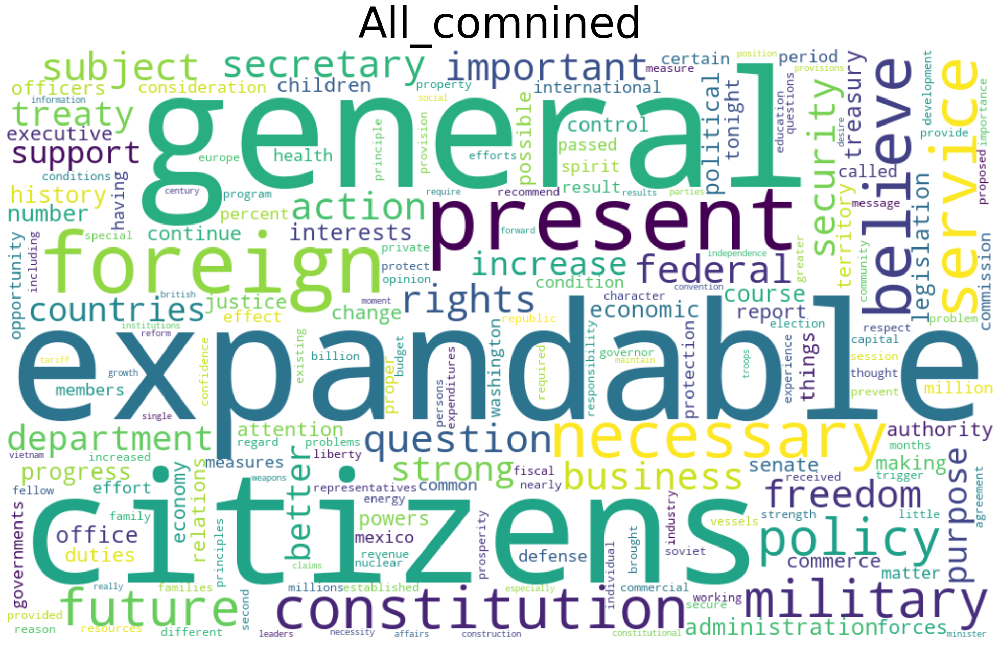

In [24]:
tempdf = FinalDF
        
#         print(tempdf)

tempdf =tempdf.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("All_comnined", fontsize=60)

In [5]:
MyPath="/Users/Max/Documents/Text mining /Raw_text_speeches_Coded_President_Parties/"

## Now - ALWAYS takes the time to make sure that you can access files
## In other words - TEST you Code!

# Biden_files=os.listdir(MyPath+"/Biden")
# # print(Biden_files)
# Wash_files=os.listdir(MyPath+"/Washington")
# # print(Wash_files)
MyCompleteFileNames=[]
MyLabels=[]


##_-----------------------------------------------------------
for folderName in ['Republican', 'Whig', 'Democrat', 'Democratic-Republican', 'Federalist']:
    ## Get the files 
    filenames=os.listdir(MyPath + folderName)
    #print(filenames)  
    
    
    for eachfile in filenames:
#         print(eachfile)
        ## The "str" assures that everything is a string
        if eachfile != ".ipynb_checkpoints":
            fullpath=MyPath + str(folderName) + "/" + str(eachfile)
            # C:/Users/profa/Documents/Python Scripts/TextMining/Week2_3/POS/P1.txt
    #         print(fullpath)
            MyCompleteFileNames.append(fullpath)
            MyLabels.append(folderName)
        
# print("THe labels are:\n")
# print(MyLabels)     

# print("THe complete list of file paths is:\n")
# print(MyCompleteFileNames)     

########################### Next, we can use
## The proper CountVecotorizer and process the text data WITH the labels...   

## Now - let's use fit.transform to transform the list of files                                 
MyTextData1 = My_FN_CV.fit_transform(MyCompleteFileNames)
## MyTextData1 is a DTM
# print(type(MyTextData1))
## Get the column names
MyCol_Names=My_FN_CV.get_feature_names_out()
## Be careful - if you print all the col names there may be 100s or 1000s :)

## Create the dataframe...
parties_df = pd.DataFrame(MyTextData1.toarray(), columns=MyCol_Names)
# print(MyDF_Pos_Neg.head())

# print(type(MyLabels))
## It is a list. 
## Let's 
parties_df['LABELS_'] = MyLabels
## Check it now
# print(FinalDF.head())




######### NOTICE that the data frame has numbers as columns.
## This is not good unless you are specifically looking for numeric values

## Remove all columns with numbers
# print("The first DF is: \n", FinalDF.head())
####### Clean-up ------------>
RemoveWords=["href", "class", "div", "block", "nav", "pagination", 
             "space", "https", "http", "template", "squarespace", "id", "jpg", "image",
             "header", "function", "folder", 'drupal',"transcript","applause"]


for nextcol in parties_df.columns:
    if(re.search(r'[^A-Za-z]+', nextcol)):
#         print(nextcol)
        parties_df=parties_df.drop([nextcol], axis=1)
#    ## The following will remove any column with name
#    ## of 3 or smaller - like "it" or "of" or "pre".
#    ##print(len(nextcol))  ## check it first
#    ## NOTE: You can also use this code to CONTROL
#    ## the words in the columns. For example - you can
#    ## have only words between lengths 5 and 9. 
#    ## In this case, we remove columns with words <= 3.

    elif(len(str(nextcol))<6):
#                 print(nextcol)
        parties_df=parties_df.drop([nextcol], axis=1)
    elif(len(str(nextcol))>15):
#                 print(nextcol)
        parties_df=parties_df.drop([nextcol], axis=1)
    elif(nextcol in RemoveWords):
#                 print(nextcol)
        parties_df=parties_df.drop([nextcol], axis=1)
    elif(len(str(nextcol))<=3):
        print(nextcol)
        parties_df=parties_df.drop([nextcol], axis=1)
print(parties_df)        
    

        



      abandon  abandoned  abandoning  abandonment  abandons  abashed  abated  \
0           0          0           0            0         0        0       0   
1           0          0           0            0         0        0       0   
2           1          1           0            1         0        0       0   
3           0          2           0            0         0        0       0   
4           0          0           0            0         0        0       0   
...       ...        ...         ...          ...       ...      ...     ...   
1029        0          0           0            0         0        0       0   
1030        1          0           0            0         0        0       0   
1031        1          0           0            0         0        0       0   
1032        0          0           0            0         0        0       0   
1033        0          0           0            0         0        0       0   

      abatement  abating  abbott  ...  

In [6]:
parties_df['LABELS_'] = MyLabels

In [7]:
republican_df = parties_df[parties_df['LABELS_'] == "Republican"]
democrat_df = parties_df[parties_df['LABELS_'] == "Democrat"]
whig_df = parties_df[parties_df['LABELS_'] == "Whig"]
dr_df = parties_df[parties_df['LABELS_'] == "Democratic-Republican"]
fed_df = parties_df[parties_df['LABELS_'] == 'Federalist']

Text(0.5, 1.0, 'All_republican')

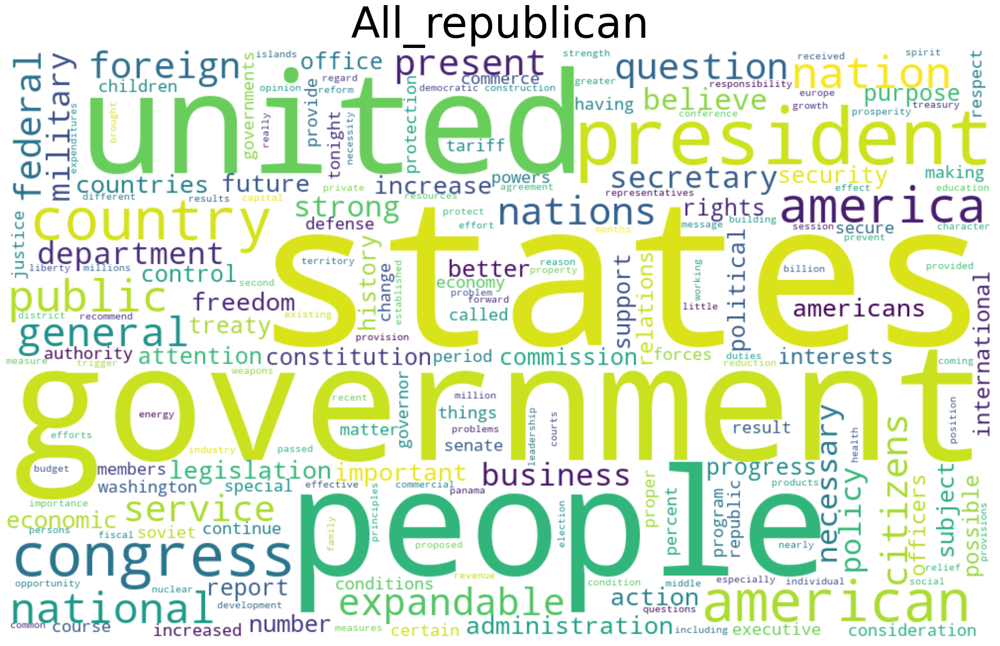

In [8]:
tempdf =republican_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("All_republican", fontsize=60)

Text(0.5, 1.0, 'All_democrat')

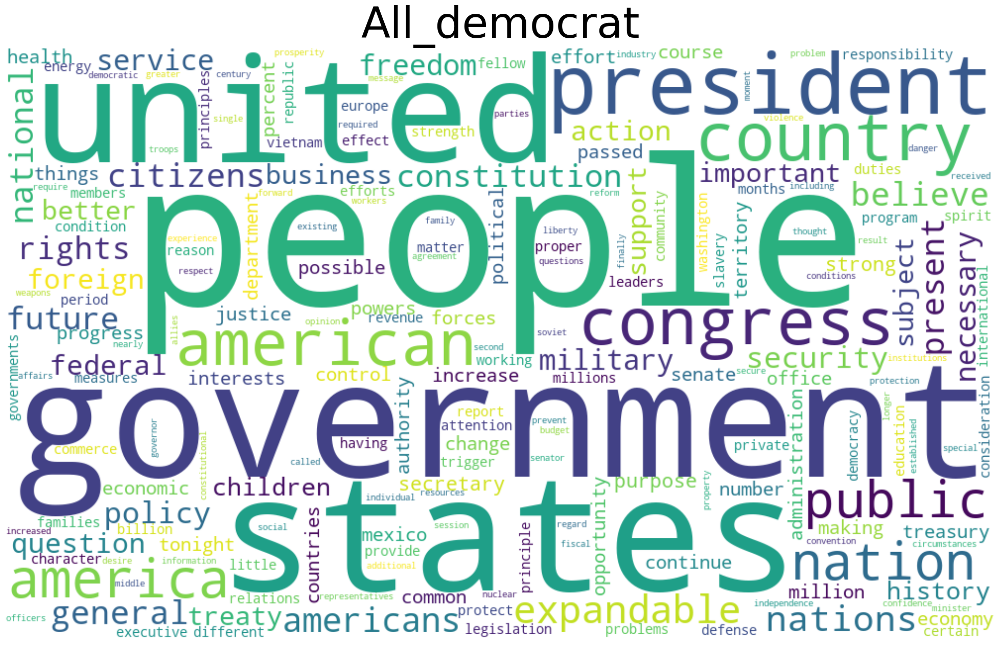

In [9]:
tempdf =democrat_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("All_democrat", fontsize=60)

Text(0.5, 1.0, 'All_whig')

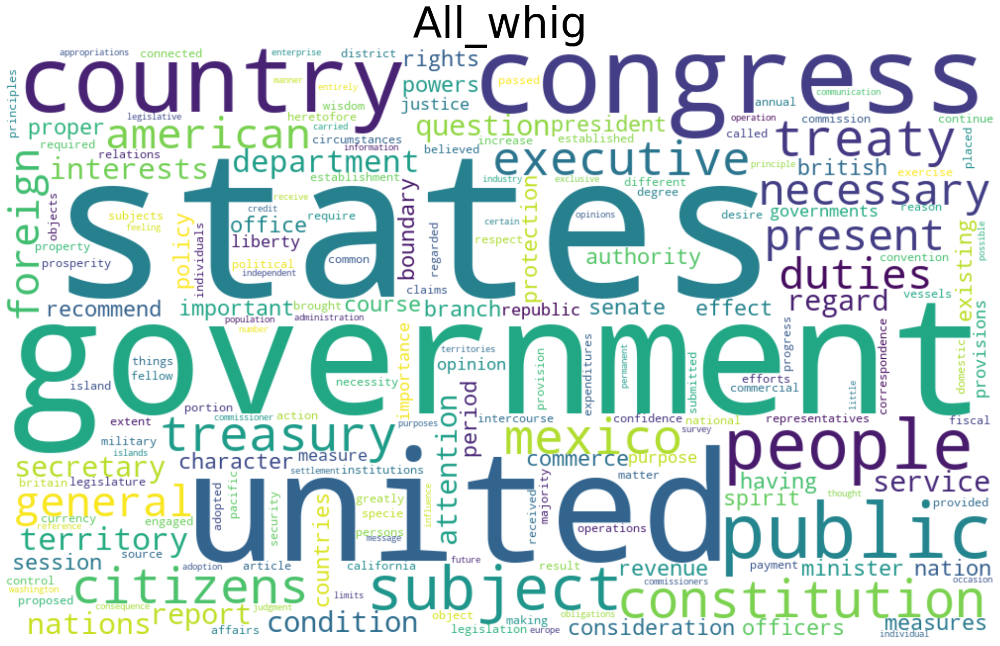

In [10]:
tempdf =whig_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("All_whig", fontsize=60)

Text(0.5, 1.0, 'All_federalist')

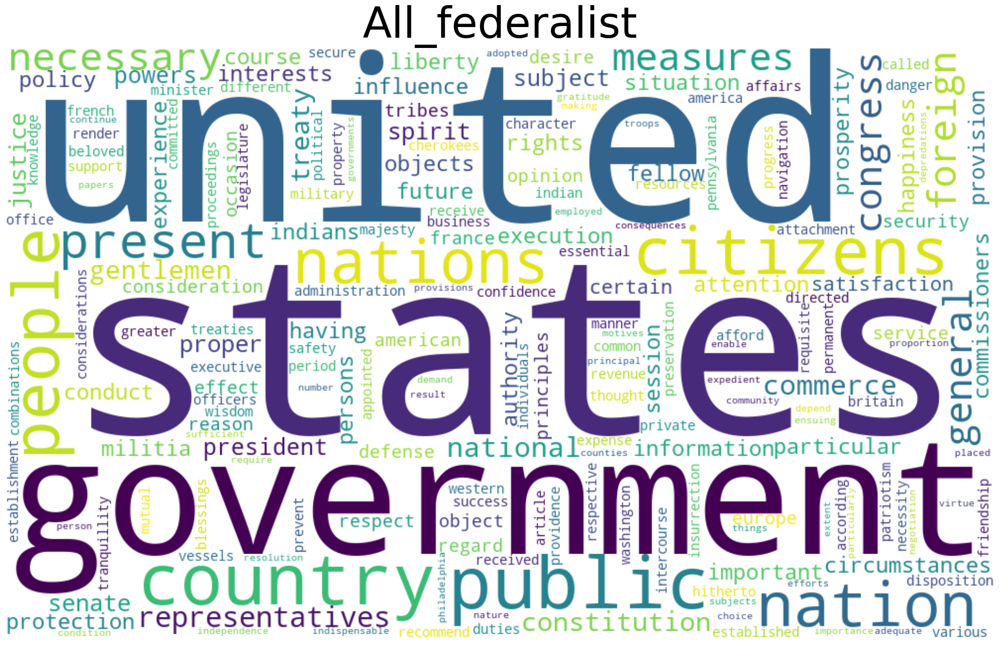

In [11]:
tempdf =fed_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("All_federalist", fontsize=60)

Text(0.5, 1.0, 'All_democratic-republican')

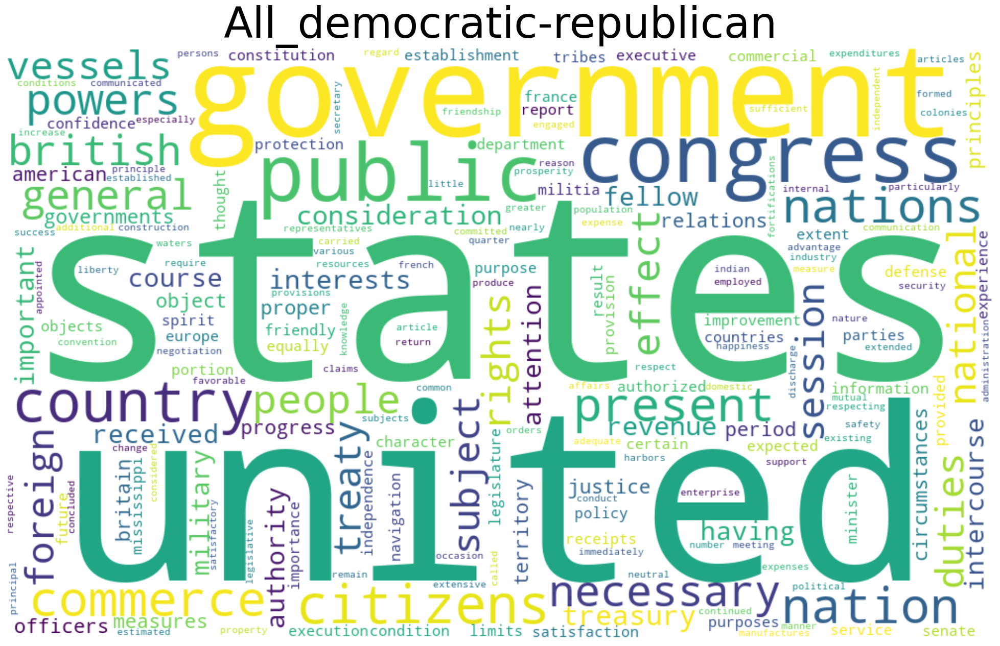

In [12]:
tempdf =dr_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("All_democratic-republican", fontsize=60)

Text(0.5, 1.0, 'Cleaned_Republican')

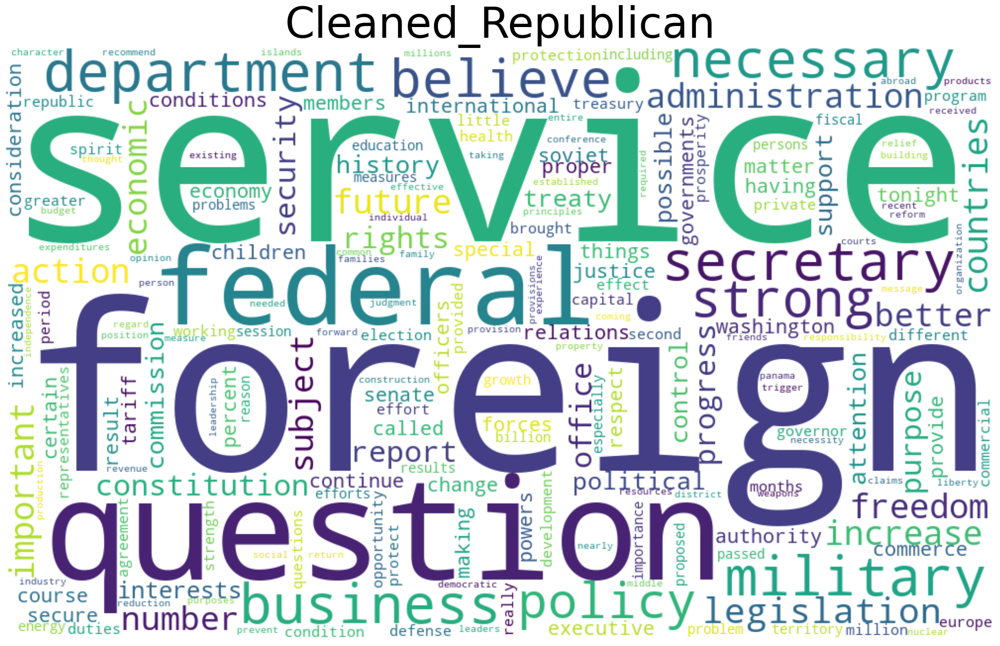

In [62]:
RemoveWords=["states",'government',"american","america","country","americans","united","people","president","congress",
            "national","nations","public","nation","general","expandable","citizens","present"]


for nextcol in republican_df.columns:
    
    if(nextcol in RemoveWords):
#                 print(nextcol)
        republican_df=republican_df.drop([nextcol], axis=1)
    elif(len(str(nextcol))<=3):
#         print(nextcol)
        republican_df=republican_df.drop([nextcol], axis=1)

    

tempdf =republican_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("Cleaned_Republican", fontsize=60)

Text(0.5, 1.0, 'Cleaned_democrat')

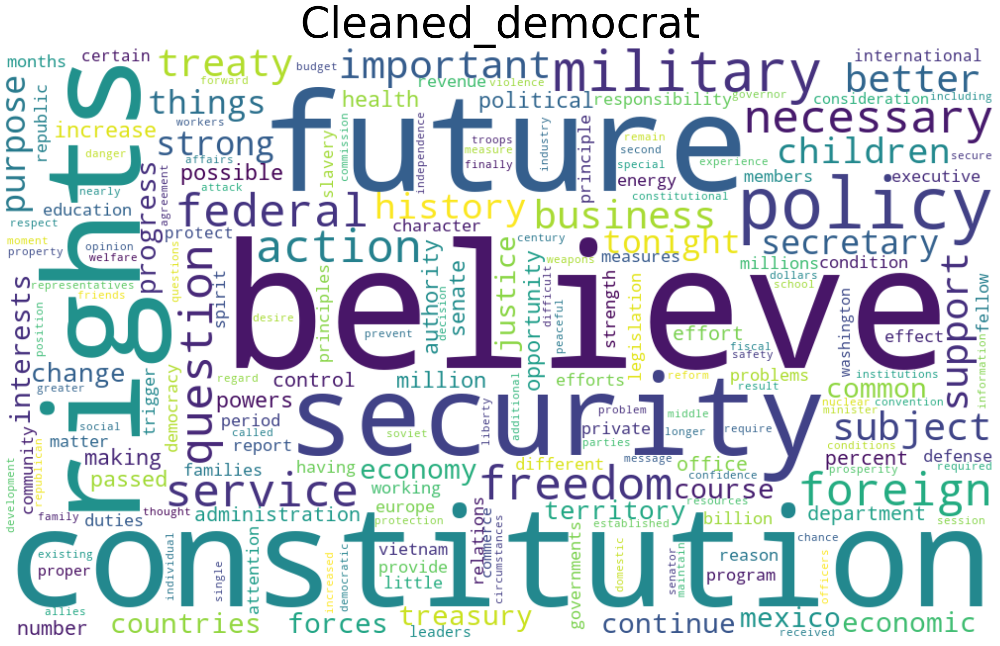

In [63]:
RemoveWords=["states",'government',"american","america","country","americans","united","people","president","congress",
            "national","nations","public","nation","general","expandable","citizens","present"]


for nextcol in democrat_df.columns:
    
    if(nextcol in RemoveWords):
#                 print(nextcol)
        democrat_df=democrat_df.drop([nextcol], axis=1)
    elif(len(str(nextcol))<=3):
#         print(nextcol)
        democrat_df=democrat_df.drop([nextcol], axis=1)

    

tempdf =democrat_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("Cleaned_democrat", fontsize=60)

Text(0.5, 1.0, 'Cleaned_whig')

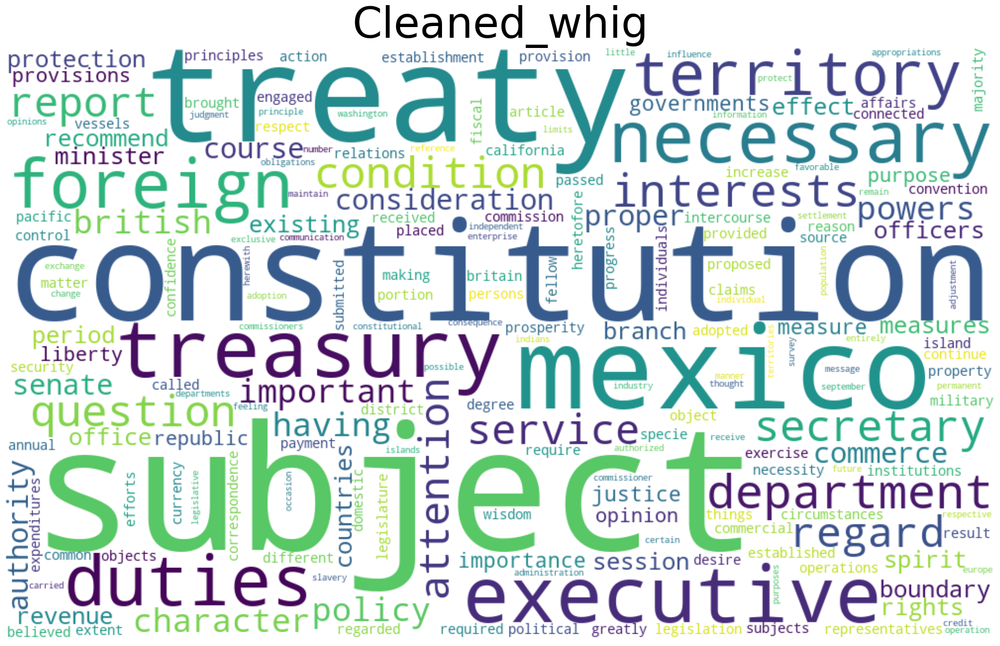

In [64]:
RemoveWords=["states",'government',"american","america","country","americans","united","people","president","congress",
            "national","nations","public","nation","general","expandable","citizens","present"]


for nextcol in whig_df.columns:
    
    if(nextcol in RemoveWords):
#                 print(nextcol)
        whig_df=whig_df.drop([nextcol], axis=1)
    elif(len(str(nextcol))<=3):
#         print(nextcol)
        whig_df=whig_df.drop([nextcol], axis=1)

    

tempdf =whig_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("Cleaned_whig", fontsize=60)

Text(0.5, 1.0, 'Cleaned_democratic-republican')

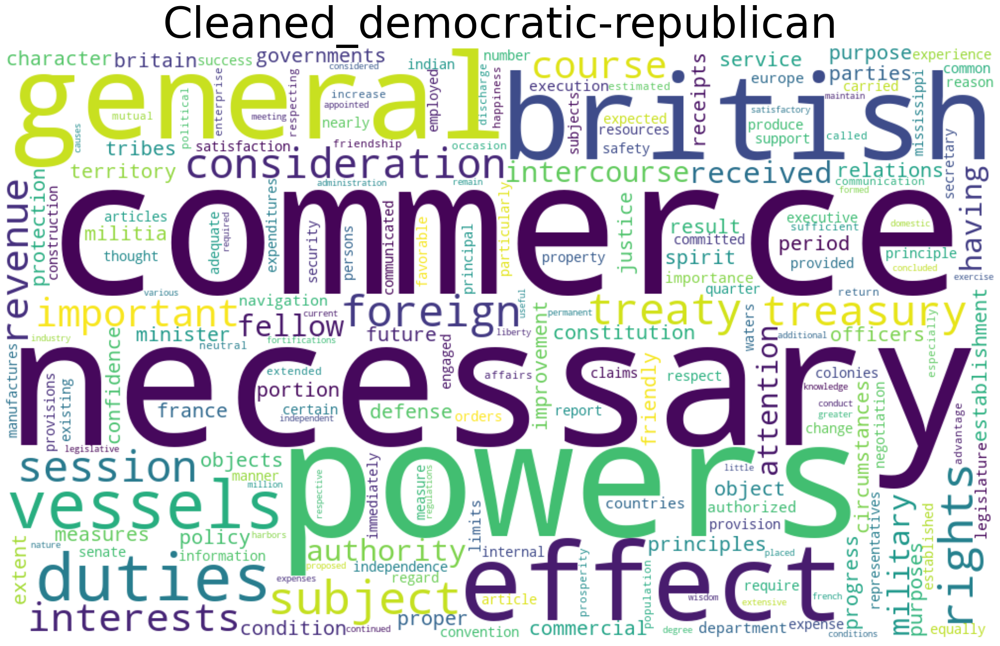

In [65]:
RemoveWords=["states",'government',"american","america","country","americans","united","people","president","congress",
            "national","nations","public","nation","expandable","citizens","present"]


for nextcol in dr_df.columns:
    
    if(nextcol in RemoveWords):
#                 print(nextcol)
        dr_df=dr_df.drop([nextcol], axis=1)
    elif(len(str(nextcol))<=3):
#         print(nextcol)
        dr_df=dr_df.drop([nextcol], axis=1)

    

tempdf =dr_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("Cleaned_democratic-republican", fontsize=60)

Text(0.5, 1.0, 'Cleaned_federalist')

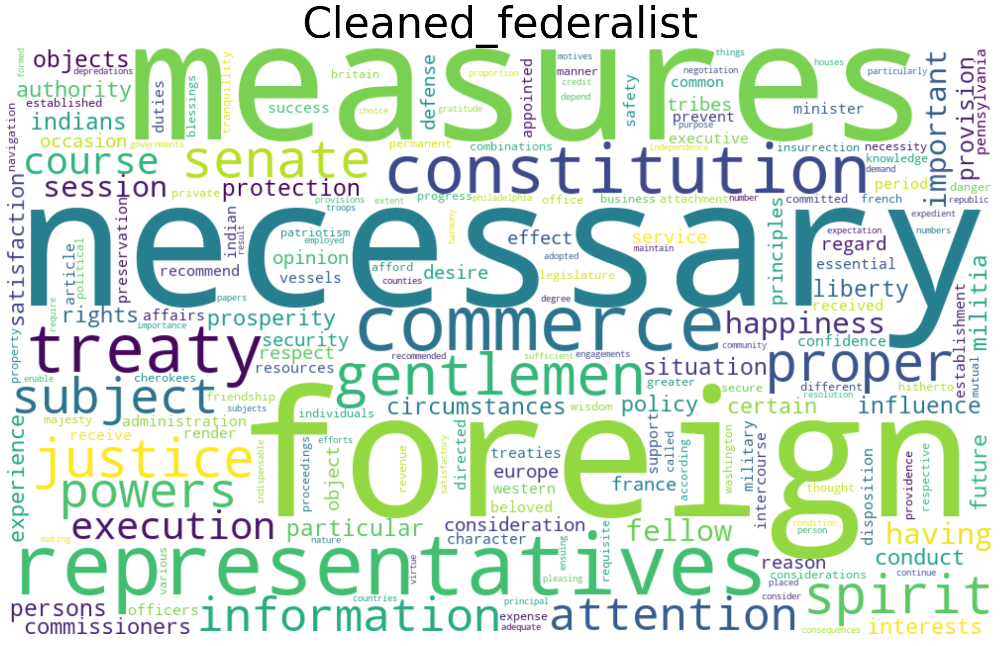

In [66]:
RemoveWords=["states",'government',"american","america","country","americans","united","people","president","congress",
            "national","nations","public","nation","general","expandable","citizens","present"]


for nextcol in fed_df.columns:
    
    if(nextcol in RemoveWords):
#                 print(nextcol)
        fed_df=fed_df.drop([nextcol], axis=1)
    elif(len(str(nextcol))<=3):
#         print(nextcol)
        fed_df=fed_df.drop([nextcol], axis=1)

    

tempdf =fed_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("Cleaned_federalist", fontsize=60)

In [67]:
import altair as alt

In [68]:
visual_df = parties_df["LABELS_"]
visual_df = pd.DataFrame(visual_df)
visual_df

,LABELS_
0,Republican
1,Republican
2,Republican
3,Republican
4,Republican
...,...
1029,Federalist
1030,Federalist
1031,Federalist
1032,Federalist


In [69]:
visual_df_Pres = FinalDF["LABEL"]
visual_df_Pres = pd.DataFrame(visual_df_Pres)
visual_df_Pres

,LABEL
0,Coolidge
1,Coolidge
2,Coolidge
3,Coolidge
4,Coolidge
...,...
1029,Jackson
1030,Jackson
1031,Jackson
1032,Jackson


In [80]:
alt.Chart(visual_df).mark_bar().encode(
   alt.X('count():Q', sort=alt.EncodingSortField(field="LABELS_", op="count", order='descending')),
   alt.Y('LABELS_:N')).configure_title(
    fontSize=20,
    font='Courier',
    anchor='start',
    color='gray'
).properties(
    title='Corpus Content by Political Party'
)


alt.Chart(...)

In [78]:
alt.Chart(visual_df_Pres).mark_bar().encode(
   alt.X('LABEL:N', sort=alt.EncodingSortField(field="LABEL", op="count", order='descending')),
   alt.Y('count():Q'),tooltip = ["count()"]
).configure_title(
    fontSize=20,
    font='Courier',
    anchor='start',
    color='gray'
).properties(
    title='Corpus Content by President'
)


alt.Chart(...)

Text(0.5, 1.0, 'Cleaned_TFID')

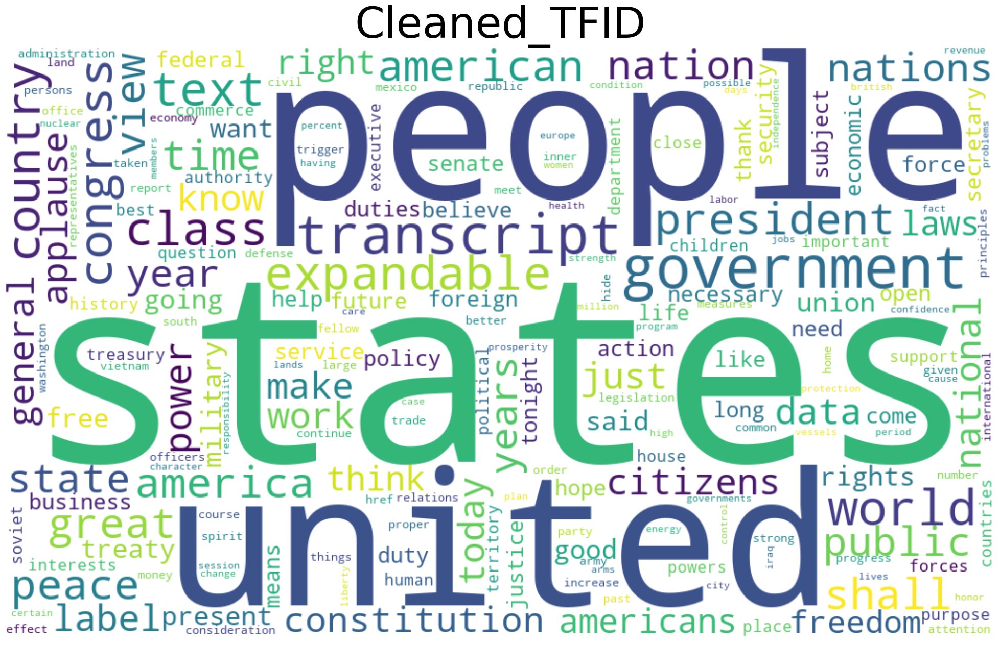

In [126]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer 

MyPath="/Users/Max/Documents/Text mining /Raw_text_speeches_Coded_President_Parties/"

## Now - ALWAYS takes the time to make sure that you can access files
## In other words - TEST you Code!

# Biden_files=os.listdir(MyPath+"/Biden")
# # print(Biden_files)
# Wash_files=os.listdir(MyPath+"/Washington")
# # print(Wash_files)
MyCompleteFileNames=[]
MyLabels=[]


##_-----------------------------------------------------------
for folderName in ['Republican', 'Whig', 'Democrat', 'Democratic-Republican', 'Federalist']:
    ## Get the files 
    filenames=os.listdir(MyPath + folderName)
    #print(filenames)  
    
    
    for eachfile in filenames:
#         print(eachfile)
        ## The "str" assures that everything is a string
        if eachfile != ".ipynb_checkpoints":
            fullpath=MyPath + str(folderName) + "/" + str(eachfile)
            # C:/Users/profa/Documents/Python Scripts/TextMining/Week2_3/POS/P1.txt
    #         print(fullpath)
            MyCompleteFileNames.append(fullpath)
            MyLabels.append(folderName)
        
# print("THe labels are:\n")
# print(MyLabels)     

# print("THe complete list of file paths is:\n")
# print(MyCompleteFileNames)     

MyVect_TF=TfidfVectorizer(input='filename', stop_words="english",max_features=1000)
Vect = MyVect_TF.fit_transform(MyCompleteFileNames)
ColumnNamesTF=MyVect_TF.get_feature_names_out()
CorpusDF_TF=pd.DataFrame(Vect.toarray(),columns=ColumnNamesTF)
# print(CorpusDF_TF)

for nextcol in CorpusDF_TF.columns:
    if(re.search(r'[^A-Za-z]+', nextcol)):
#         print(nextcol)
        CorpusDF_TF=CorpusDF_TF.drop([nextcol], axis=1)

    elif(len(str(nextcol))<4):
#                 print(nextcol)
        CorpusDF_TF=CorpusDF_TF.drop([nextcol], axis=1)
    elif(len(str(nextcol))>15):
#                 print(nextcol)
        CorpusDF_TF=CorpusDF_TF.drop([nextcol], axis=1)
#     elif(nextcol in RemoveWords):
# #                 print(nextcol)
#         FinalDF=FinalDF.drop([nextcol], axis=1)
    elif(len(str(nextcol))<=3):
        print(nextcol)
        CorpusDF_TF=CorpusDF_TF.drop([nextcol], axis=1)
CorpusDF_TF['LABEL'] = MyLabels
# print(CorpusDF_TF)                                
CorpusDF_TF.to_csv("CorpusDF_Tfid_politics.csv")
tempdf =CorpusDF_TF.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("Cleaned_TFID", fontsize=60)
    

        



In [128]:
CorpusDF_TF

,ability,able,abroad,accept,accomplished,according,account,action,acts,actual,...,workers,working,works,world,wrong,year,years,york,young,LABEL
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.095858,0.000000,0.000000,0.115392,0.000000,0.000000,0.000000,Republican
1,0.027092,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.000000,0.032698,0.000000,0.000000,0.016415,0.000000,0.000000,Republican
2,0.008637,0.013696,0.000000,0.009259,0.000000,0.000000,0.000000,0.067219,0.016884,0.009724,...,0.0,0.007847,0.028223,0.052122,0.027908,0.022650,0.068032,0.010289,0.000000,Republican
3,0.006120,0.000000,0.018023,0.000000,0.006810,0.013781,0.042729,0.047633,0.011964,0.006891,...,0.0,0.000000,0.000000,0.018467,0.000000,0.196613,0.089002,0.021873,0.011815,Republican
4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,Republican
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1029,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,Federalist
1030,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.050287,0.000000,0.000000,0.000000,...,0.0,0.000000,0.047075,0.026081,0.000000,0.056668,0.000000,0.000000,0.000000,Federalist
1031,0.000000,0.022846,0.000000,0.000000,0.064121,0.000000,0.000000,0.000000,0.028163,0.000000,...,0.0,0.000000,0.000000,0.017388,0.000000,0.037780,0.017458,0.000000,0.000000,Federalist
1032,0.000000,0.000000,0.000000,0.000000,0.000000,0.168297,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,Federalist


In [119]:
import nltk
nltk.download('wordnet')
from nltk.stem import WordNetLemmatizer 
LEMMER = WordNetLemmatizer() 

from nltk.stem.porter import PorterStemmer
STEMMER=PorterStemmer()

[nltk_data] Downloading package wordnet to /Users/Max/nltk_data...


In [120]:

# print(LEMMER.lemmatize("singers"))




def MY_LEMMER(str_input):
    words = re.sub(r"[^A-Za-z\-]", " ", str_input).lower().split()
    words = [LEMMER.lemmatize(word) for word in words]
    return words

print(MY_LEMMER("Hiking is loved by hikers and hikes!! 1234"))


['hiking', 'is', 'loved', 'by', 'hiker', 'and', 'hike']


In [114]:
MyPath="/Users/Max/Documents/Text mining /Raw_text_speeches_Coded_President_Parties/"
def MY_STEMMER(str_input):
    words = re.sub(r"[^A-Za-z\-]", " ", str_input).lower().split()
    words = [STEMMER.stem(word) for word in words]
    return words
## Now - ALWAYS takes the time to make sure that you can access files
## In other words - TEST you Code!

# Biden_files=os.listdir(MyPath+"/Biden")
# # print(Biden_files)
# Wash_files=os.listdir(MyPath+"/Washington")
# # print(Wash_files)
def MY_STEMMER(str_input):
    words = re.sub(r"[^A-Za-z\-]", " ", str_input).lower().split()
    words = [STEMMER.stem(word) for word in words]
    return words
MyCompleteFileNames=[]
MyLabels=[]
My_FN_CV_Stimmer = CountVectorizer(input = "filename",tokenizer=MY_STEMMER, stop_words="english")


##_-----------------------------------------------------------
for folderName in ['Republican', 'Whig', 'Democrat', 'Democratic-Republican', 'Federalist']:
    ## Get the files 
    filenames=os.listdir(MyPath + folderName)
    #print(filenames)  
    
    
    for eachfile in filenames:
#         print(eachfile)
        ## The "str" assures that everything is a string
        if eachfile != ".ipynb_checkpoints":
            fullpath=MyPath + str(folderName) + "/" + str(eachfile)
            # C:/Users/profa/Documents/Python Scripts/TextMining/Week2_3/POS/P1.txt
    #         print(fullpath)
            MyCompleteFileNames.append(fullpath)
            MyLabels.append(folderName)
        
# print("THe labels are:\n")
# print(MyLabels)     

# print("THe complete list of file paths is:\n")
# print(MyCompleteFileNames)     

########################### Next, we can use
## The proper CountVecotorizer and process the text data WITH the labels...   

## Now - let's use fit.transform to transform the list of files                                 
MyTextData1 = My_FN_CV_Stimmer.fit_transform(MyCompleteFileNames)
## MyTextData1 is a DTM
# print(type(MyTextData1))
## Get the column names
MyCol_Names=My_FN_CV_Stimmer.get_feature_names_out()
## Be careful - if you print all the col names there may be 100s or 1000s :)

## Create the dataframe...
parties_df = pd.DataFrame(MyTextData1.toarray(), columns=MyCol_Names)
# print(MyDF_Pos_Neg.head())

# print(type(MyLabels))
## It is a list. 
## Let's 
parties_df['LABELS_'] = MyLabels
## Check it now
# print(FinalDF.head())




######### NOTICE that the data frame has numbers as columns.
## This is not good unless you are specifically looking for numeric values

## Remove all columns with numbers
# print("The first DF is: \n", FinalDF.head())
####### Clean-up ------------>
RemoveWords=["href", "class", "div", "block", "nav", "pagination", 
             "space", "https", "http", "template", "squarespace", "id", "jpg", "image",
             "header", "function", "folder", 'drupal',"transcript","applause"]

for nextcol in parties_df.columns:
    if(re.search(r'[^A-Za-z]+', nextcol)):
#         print(nextcol)
        parties_df=parties_df.drop([nextcol], axis=1)
#    ## The following will remove any column with name
#    ## of 3 or smaller - like "it" or "of" or "pre".
#    ##print(len(nextcol))  ## check it first
#    ## NOTE: You can also use this code to CONTROL
#    ## the words in the columns. For example - you can
#    ## have only words between lengths 5 and 9. 
#    ## In this case, we remove columns with words <= 3.

    elif(len(str(nextcol))<6):
#                 print(nextcol)
        parties_df=parties_df.drop([nextcol], axis=1)
    elif(len(str(nextcol))>15):
#                 print(nextcol)
        parties_df=parties_df.drop([nextcol], axis=1)
    elif(nextcol in RemoveWords):
#                 print(nextcol)
        parties_df=parties_df.drop([nextcol], axis=1)
    elif(len(str(nextcol))<=3):
        print(nextcol)
        parties_df=parties_df.drop([nextcol], axis=1)
# print(parties_df)        
    

        



/Users/Max/opt/anaconda3/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:528: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(
/Users/Max/opt/anaconda3/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:409: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['abov', 'afterward', 'alon', 'alreadi', 'alway', 'ani', 'anoth', 'anyon', 'anyth', 'anywher', 'becam', 'becaus', 'becom', 'befor', 'besid', 'cri', 'describ', 'dure', 'els', 'elsewher', 'empti', 'everi', 'everyon', 'everyth', 'everywher', 'fifti', 'formerli', 'forti', 'ha', 'henc', 'hereaft', 'herebi', 'hi', 'howev', 'hundr', 'inde', 'latterli', 'mani', 'meanwhil', 'moreov', 'mostli', 'nobodi', 'noon', 'noth', 'nowher', 'onc', 'onli', 'otherwis', 'ourselv', 'perhap', 'pleas', 'seriou', 'sever', 'sinc', 'sincer', 'sixti', 'someon', 'someth', 'sometim', 'somewher', 'themselv', 'thenc'

      abandon  abbott  abbottabad  abbrevi  abdallah  abduct  abdullah  \
0           0       0           0        0         0       0         0   
1           0       0           0        0         0       0         0   
2           3       0           0        0         0       0         0   
3           2       0           0        0         0       0         0   
4           0       0           0        0         0       0         0   
...       ...     ...         ...      ...       ...     ...       ...   
1029        0       0           0        0         0       0         0   
1030        1       0           0        0         0       0         0   
1031        1       0           0        0         0       0         0   
1032        0       0           0        0         0       0         0   
1033        0       0           0        0         0       0         0   

      aberdeen  abernathi  abettor  ...  zhivago  zimbabw  zimbabwean  \
0            0          0        0  ..

In [115]:
parties_df['LABELS_'] = MyLabels

Text(0.5, 1.0, 'Stemmer_All')

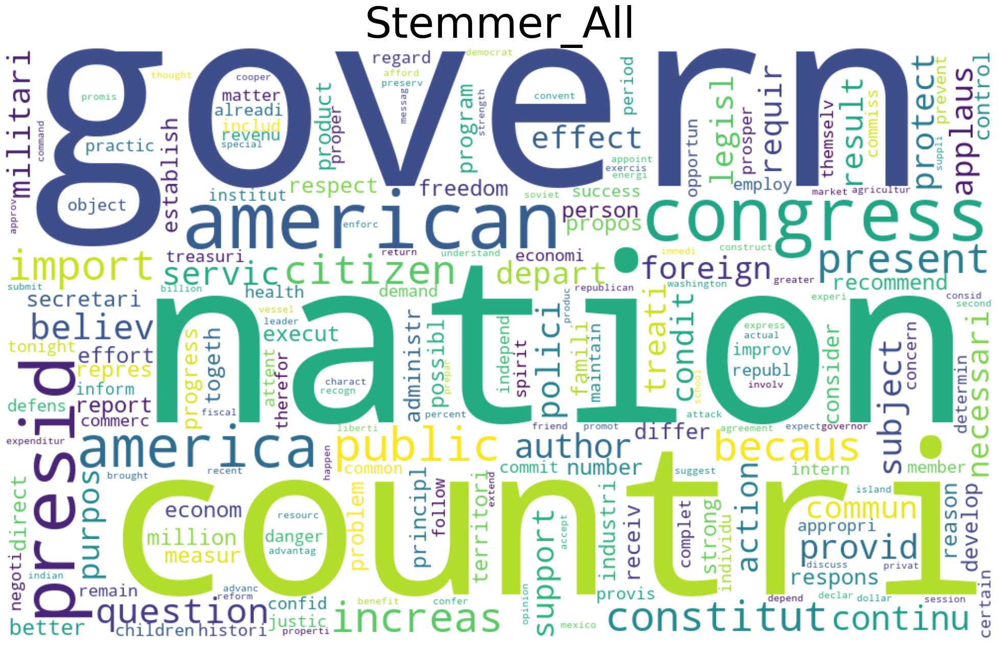

In [116]:
tempdf =parties_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)



plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("Stemmer_All", fontsize=60)

In [123]:
MyPath="/Users/Max/Documents/Text mining /Raw_text_speeches_Coded_President_Parties/"
## Now - ALWAYS takes the time to make sure that you can access files
## In other words - TEST you Code!

# Biden_files=os.listdir(MyPath+"/Biden")
# # print(Biden_files)
# Wash_files=os.listdir(MyPath+"/Washington")
# # print(Wash_files)
def MY_LEMMER(str_input):
    words = re.sub(r"[^A-Za-z\-]", " ", str_input).lower().split()
    words = [LEMMER.lemmatize(word) for word in words]
    return words
MyCompleteFileNames=[]
MyLabels=[]
My_FN_CV_Lemmer = CountVectorizer(input = "filename",tokenizer=MY_LEMMER, stop_words="english")


##_-----------------------------------------------------------
for folderName in ['Republican', 'Whig', 'Democrat', 'Democratic-Republican', 'Federalist']:
    ## Get the files 
    filenames=os.listdir(MyPath + folderName)
    #print(filenames)  
    
    
    for eachfile in filenames:
#         print(eachfile)
        ## The "str" assures that everything is a string
        if eachfile != ".ipynb_checkpoints":
            fullpath=MyPath + str(folderName) + "/" + str(eachfile)
            # C:/Users/profa/Documents/Python Scripts/TextMining/Week2_3/POS/P1.txt
    #         print(fullpath)
            MyCompleteFileNames.append(fullpath)
            MyLabels.append(folderName)
        
# print("THe labels are:\n")
# print(MyLabels)     

# print("THe complete list of file paths is:\n")
# print(MyCompleteFileNames)     

########################### Next, we can use
## The proper CountVecotorizer and process the text data WITH the labels...   

## Now - let's use fit.transform to transform the list of files                                 
MyTextData1 = My_FN_CV_Lemmer.fit_transform(MyCompleteFileNames)
## MyTextData1 is a DTM
# print(type(MyTextData1))
## Get the column names
MyCol_Names=My_FN_CV_Lemmer.get_feature_names_out()
## Be careful - if you print all the col names there may be 100s or 1000s :)

## Create the dataframe...
parties_lemmer_df = pd.DataFrame(MyTextData1.toarray(), columns=MyCol_Names)
# print(MyDF_Pos_Neg.head())

# print(type(MyLabels))
## It is a list. 
## Let's 
## Check it now
# print(FinalDF.head())

parties_lemmer_df['LABELS_'] = MyLabels


######### NOTICE that the data frame has numbers as columns.
## This is not good unless you are specifically looking for numeric values

## Remove all columns with numbers
# print("The first DF is: \n", FinalDF.head())
####### Clean-up ------------>
RemoveWords=["href", "class", "div", "block", "nav", "pagination", 
             "space", "https", "http", "template", "squarespace", "id", "jpg", "image",
             "header", "function", "folder", 'drupal',"transcript","applause"]

for nextcol in parties_df.columns:
    if(re.search(r'[^A-Za-z]+', nextcol)):
#         print(nextcol)
        parties_lemmer_df=parties_lemmer_df.drop([nextcol], axis=1)
#    ## The following will remove any column with name
#    ## of 3 or smaller - like "it" or "of" or "pre".
#    ##print(len(nextcol))  ## check it first
#    ## NOTE: You can also use this code to CONTROL
#    ## the words in the columns. For example - you can
#    ## have only words between lengths 5 and 9. 
#    ## In this case, we remove columns with words <= 3.

    elif(len(str(nextcol))<6):
#                 print(nextcol)
        parties_lemmer_df=parties_lemmer_df.drop([nextcol], axis=1)
    elif(len(str(nextcol))>15):
#                 print(parties_lemmer_df)
        parties_lemmer_df=parties_lemmer_df.drop([nextcol], axis=1)
    elif(nextcol in RemoveWords):
#                 print(nextcol)
        parties_lemmer_df=parties_lemmer_df.drop([nextcol], axis=1)
    elif(len(str(nextcol))<=3):
        print(nextcol)
        parties_lemmer_df=parties_lemmer_df.drop([nextcol], axis=1)
print(parties_lemmer_df)        
    

        



/Users/Max/opt/anaconda3/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:528: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(
/Users/Max/opt/anaconda3/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:409: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ha', 'le', 'u', 'wa'] not in stop_words.
  warnings.warn(


      -  --  ---  ----------  -----------  -------------  ---------------  \
0     0   0    0           0            0              0                0   
1     0   0    0           0            0              0                0   
2     0   0    0           0            0              0                0   
3     0   0    0           0            0              0                0   
4     0   0    0           0            0              0                0   
...  ..  ..  ...         ...          ...            ...              ...   
1029  0   0    0           0            0              0                0   
1030  0   0    0           0            0              0                0   
1031  0   0    0           0            0              0                0   
1032  0   0    0           0            0              0                0   
1033  0   0    0           0            0              0                0   

      -----------------  --------------------  ---------------------  ...  

In [124]:
parties_lemmer_df['LABELS_'] = MyLabels

Text(0.5, 1.0, 'Lemmer_All')

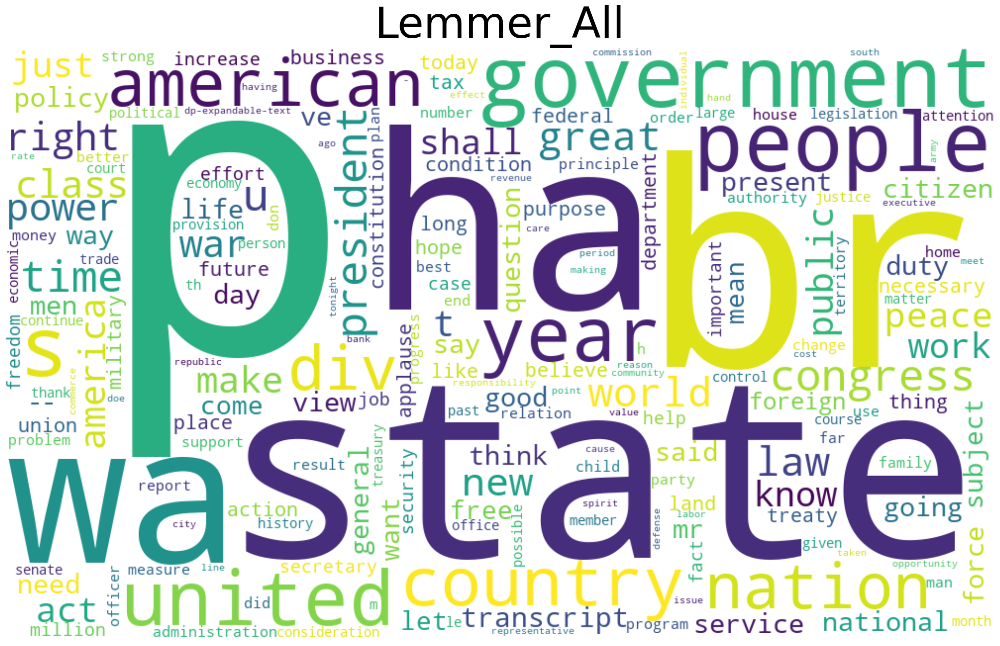

In [127]:
tempdf =parties_lemmer_df.sum(axis=0,numeric_only=True)
#         print(tempdf)

#Make var name
#         print(speech_links)
WC1=WordCloud(width=1000, height=600, background_color="white",
               min_word_length=4, #mask=next_image,
               max_words=200).generate_from_frequencies(tempdf)
## Here, this list holds all three wordclouds I am building

##########
########## Create the wordcloud
##########
fig=plt.figure(figsize=(25, 25))
#figure, axes = plt.subplots(nrows=2, ncols=2)


plt.imshow(WC1, interpolation='bilinear')
plt.axis("off")
plt.title("Lemmer_All", fontsize=60)